# `Image Processing for Newbies: using Python`

# <font color=red>Mr Fugu Data Science</font>

# (◕‿◕✿)

**<font size=5>`Help Support the channel:Patreon @mrfugudatasci`</font>**

**<font size=4>`Or Buy Me A Coffee: @mrfugudatasci`</font>**

`-------------------------------------`

In [3]:
# used to convert image to array for analysis
import numpy as np
# matplotlib relies on PIL to use image information
import matplotlib.pyplot as plt
# open and manipulate images
import PIL
# process images
from skimage import io

%matplotlib inline

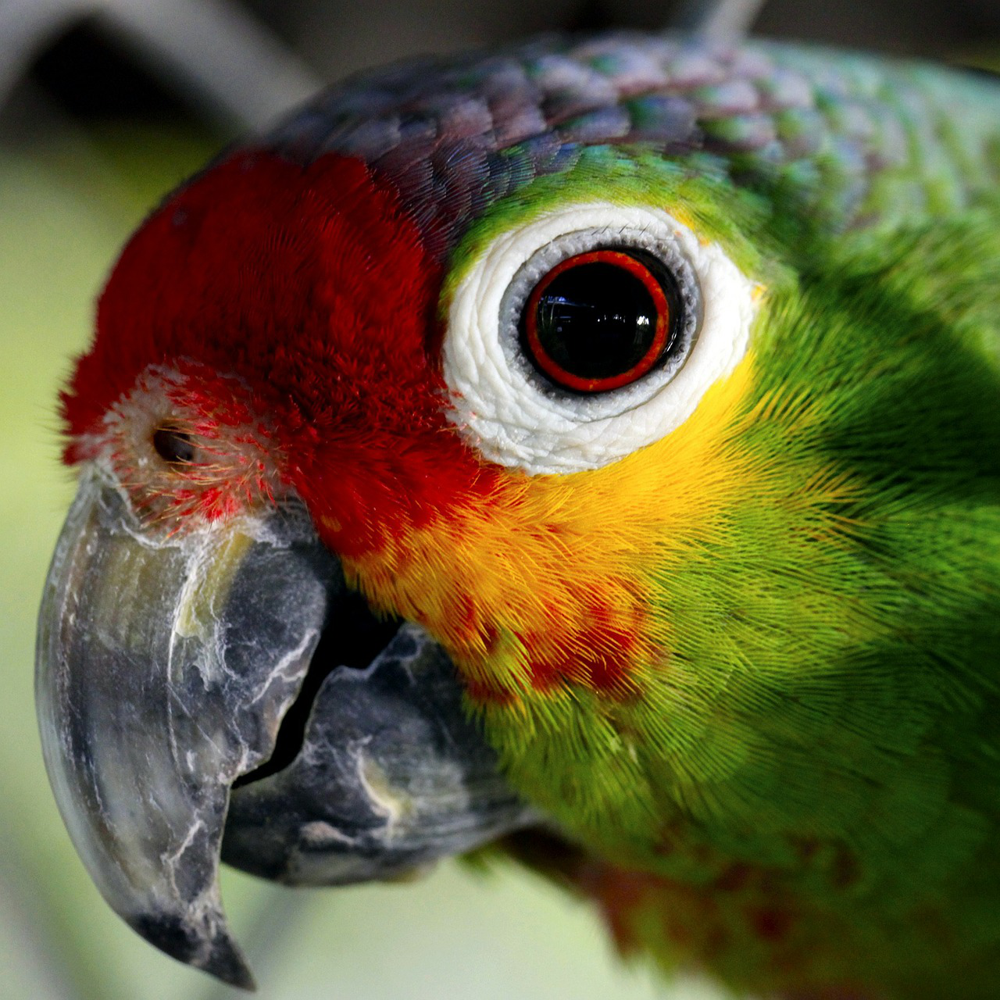

In [6]:
# Open images

parrot_= PIL.Image.open('parrot.jpg')
parrot_

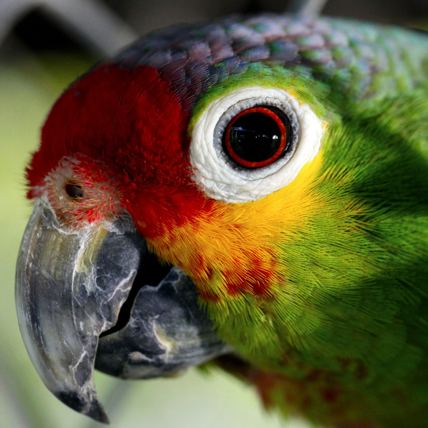

In [9]:
# rescale
parrot_.resize((428,428))

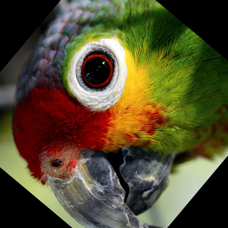

In [13]:
parrot_.rotate(50).resize((228,228))

In [15]:
print(parrot_.format, parrot_.size, parrot_.mode)

JPEG (1280, 1280) RGB


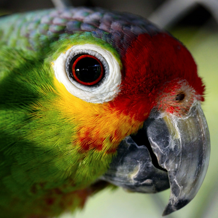

In [23]:
# flip image
parrot_.transpose(PIL.Image.FLIP_LEFT_RIGHT).resize((218,218))

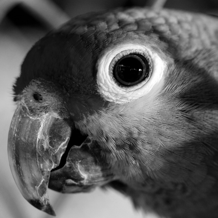

In [26]:
parrot_.convert("L").resize((218,218))

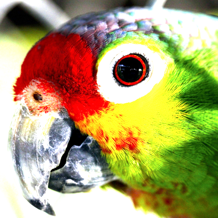

In [42]:
 parrot_.point(lambda i: i * 2.2).resize((218,218))

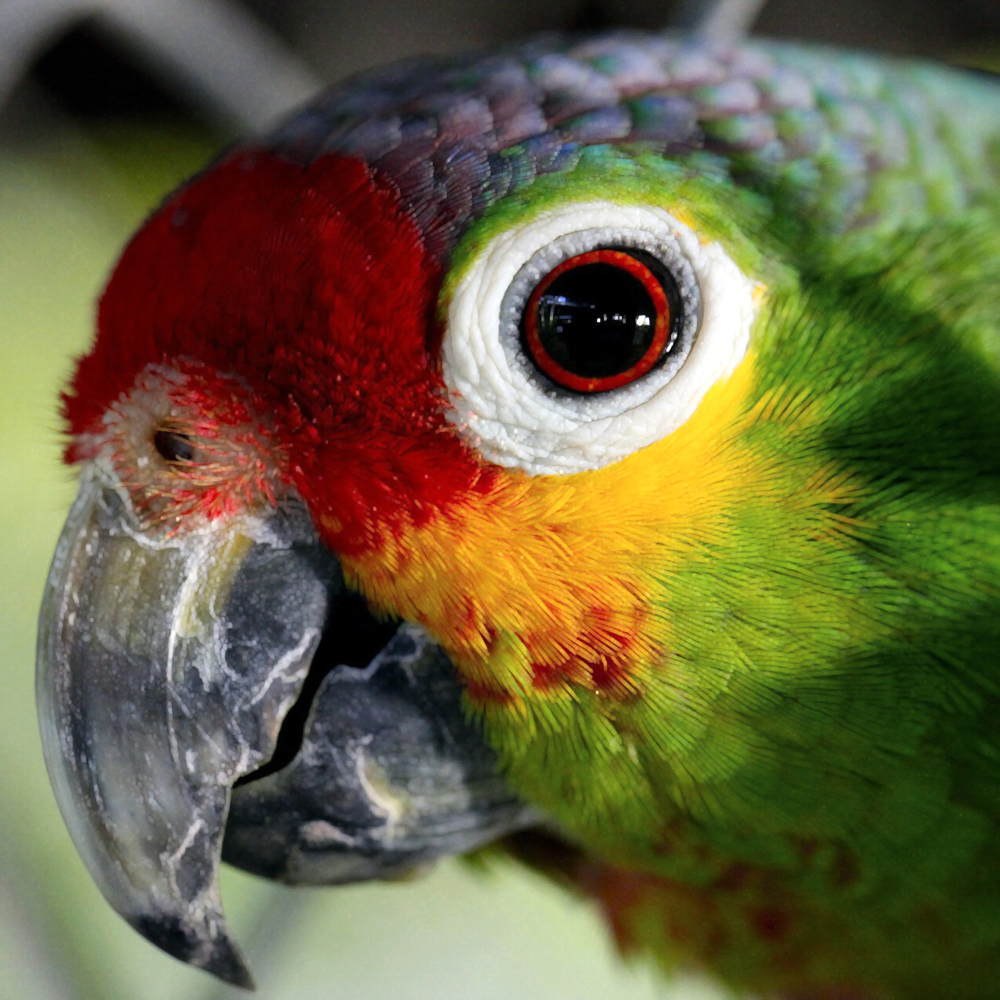

In [83]:
# parrot_.filter(ImageFilter.BLUR)

from PIL import ImageFilter
parrot_.filter(ImageFilter.MaxFilter)

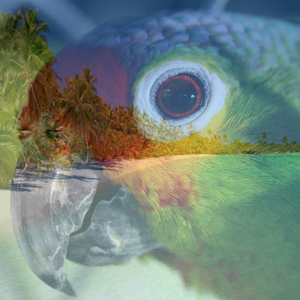

In [131]:

beach=PIL.Image.open('beach.jpg')
bch=beach.resize(parrot_.size)

mask = PIL.Image.new("L", parrot_.size, 128)
im = PIL.Image.composite(parrot_, bch, mask)
# im = PIL.Image.blend(parrot_, bch, 0.8)
im.resize((300,300))

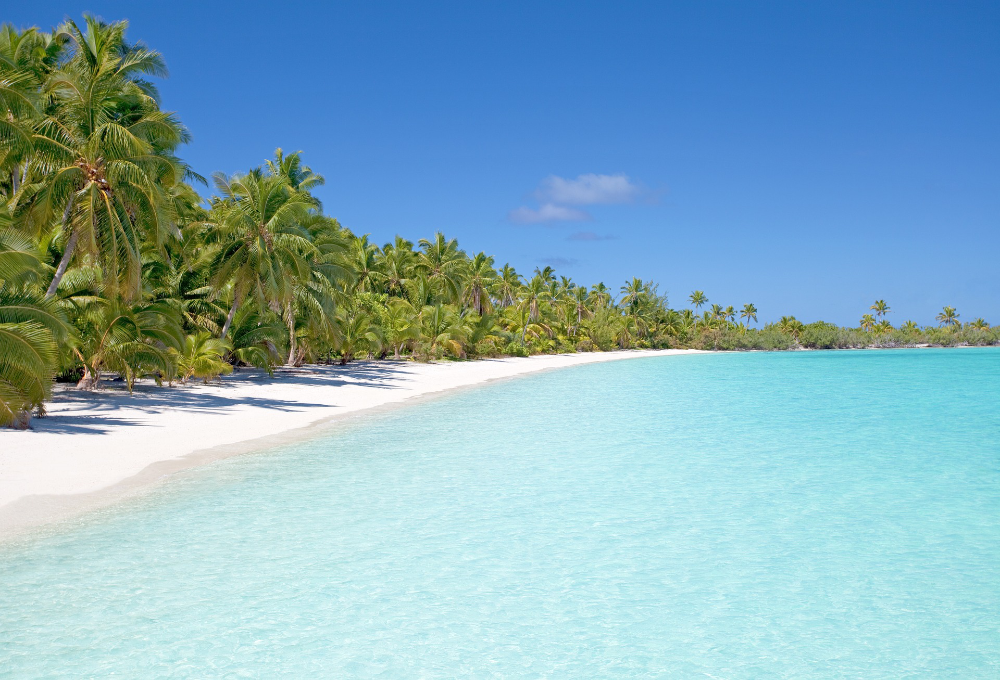

In [263]:
# Thumbnail: preserves aspect ratio

# beach.thumbnail((256,256))
beach

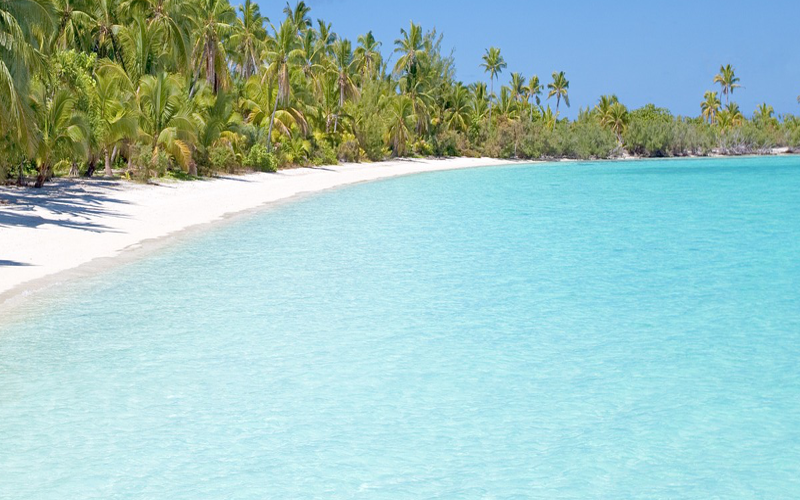

In [276]:
# img.crop(left,top,right,bottom)

bch.crop((400, 500, 1200, 1000))

# `Gamma Correction:`

+ Each pixel in an image has a brightness of (0:1) referred to as luminance.
    + 0: black
    + 1: white
+ We have (RGB), specifying the pixel color and we also, have 3 channels of information.
    + We take the pixel brightness of RGB and average it which is called luminance.
    
<font size=4>$O = (\frac{I}{255})^{\gamma}*255$</font>

* If $\gamma < 1$: the image appears darker
* $\gamma > 1$: appears lighter
* $\gamma = 1$: get back original image



Our eyes perceive color and luminance different from digital signals.
+ Understand that a sensor in a camera is more sensitive and our eyes will only capture a fraction of the brightness.
    + A camera has a linear relationship with brightness vs our eyes which are non-linear. 

FIGURE 01: GAMMA CORRECTION PLOT


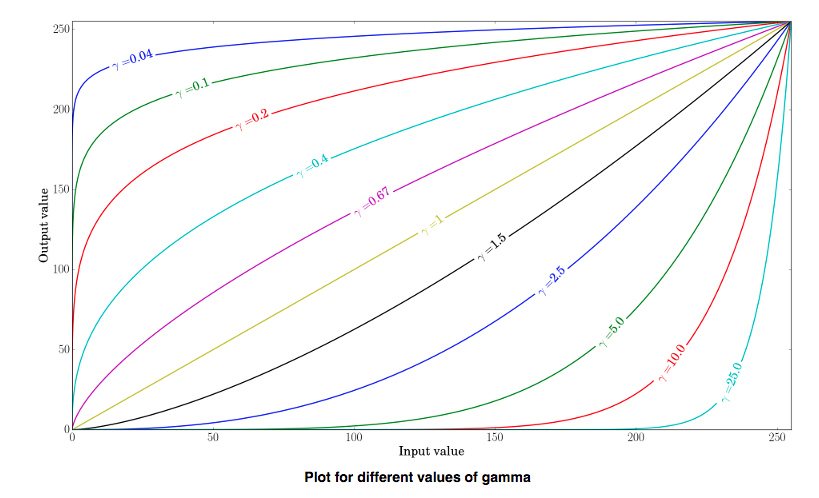

In [302]:
print('FIGURE 01: GAMMA CORRECTION PLOT')
PIL.Image.open('gamma_correct.jpg')


Observe from **`figure 01`** (*above*):

+ `Input values`: 
    + Pixels on the extreme edges will have less effect than those more centrally located. This occurs since we are dealing with non-linear relationship and therefore not all pixels have the same effect.
        + The outer pixels either toward (0,255) will need drastic $\gamma$ values to change their brightness
    + As you increase $\gamma$, the output will become whiter or more washed out
        + Reverse for darker pixels
        

FIGURE 02: (left) Eye Perception, (right) Camera


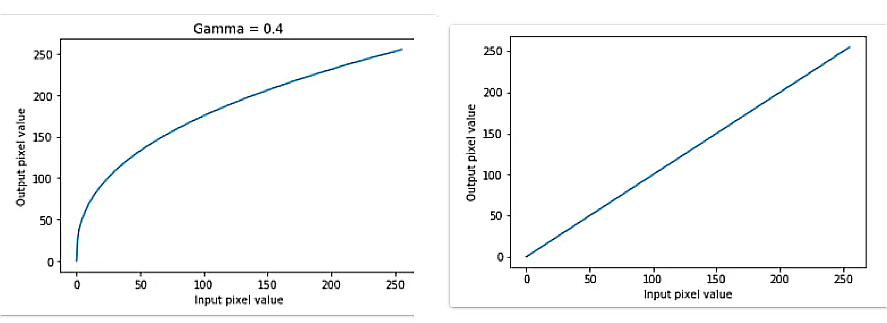

In [312]:
print('FIGURE 02: (left) Eye Perception, (right) Camera')
PIL.Image.open('fig02a.jpg').filter(ImageFilter.EDGE_ENHANCE)

**`Figure 02`**:
+ left: our eyes perceving brightness, look into Steven's Power Law
+ right: linear relationship for camera brightness 

FIGURE 03: Changing Brightness with Gamma Correction


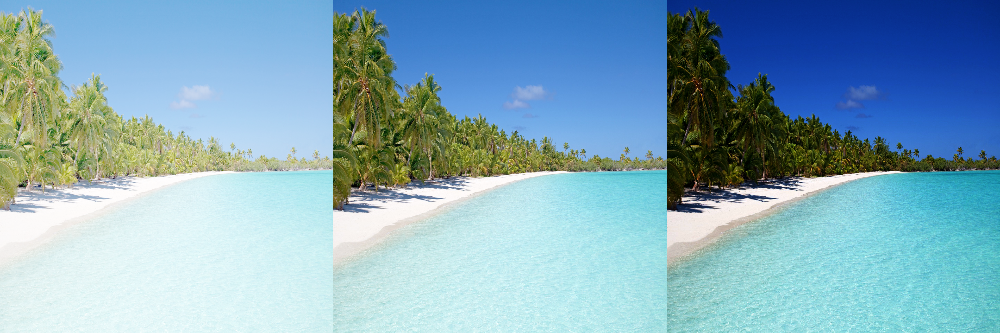

In [313]:
print('FIGURE 03: Changing Brightness with Gamma Correction')

im_1_22 = 255.0 * (np.array(bch) / 255.0)**(1 / 2.2)
im_22 = 255.0 * (np.array(bch) / 255.0)**2.2

im_gamma = np.concatenate((im_1_22, bch, im_22), axis=1)

pil_img = PIL.Image.fromarray(np.uint8(im_gamma))
pil_img


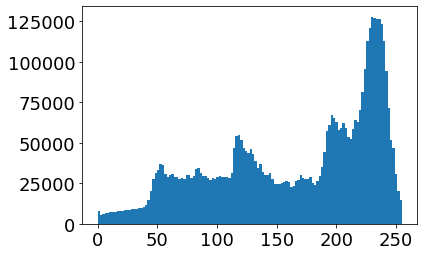

In [437]:
# Histogram of Original Beach Image:
plt.hist(np.array(bch).flatten(),128)
plt.show()

FIGURE 04: Observe Histogram Changes with Gamma Correction


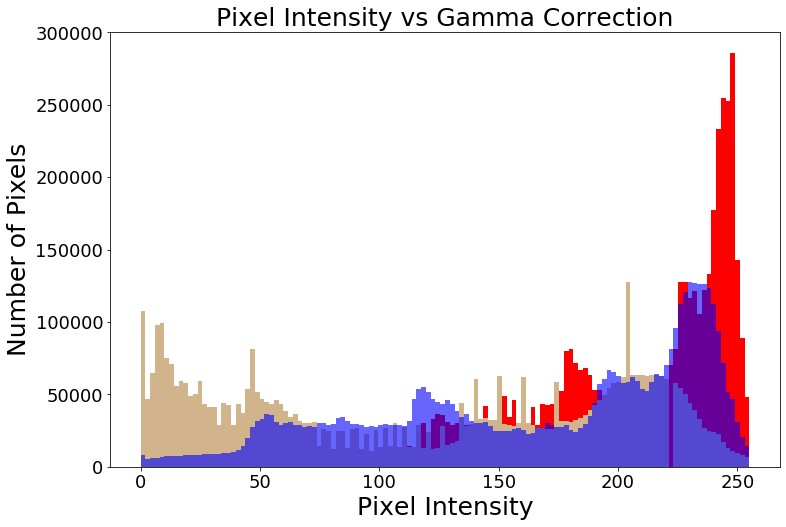

In [436]:
print('FIGURE 04: Observe Histogram Changes with Gamma Correction')
plt.figure(figsize=(12,8))
plt.rc('xtick', labelsize=18) 
plt.rc('ytick', labelsize=18)

plt.ylabel('Number of Pixels',size=25)
plt.xlabel('Pixel Intensity',size=25)
plt.title('Pixel Intensity vs Gamma Correction',size=25)



plt.hist(np.array(im_1_22).flatten(),128,color='red')
plt.hist(np.array(im_22).flatten(),128,color='tan')
plt.hist(np.array(bch).flatten(),128,color='blue',alpha=.6)
plt.show()

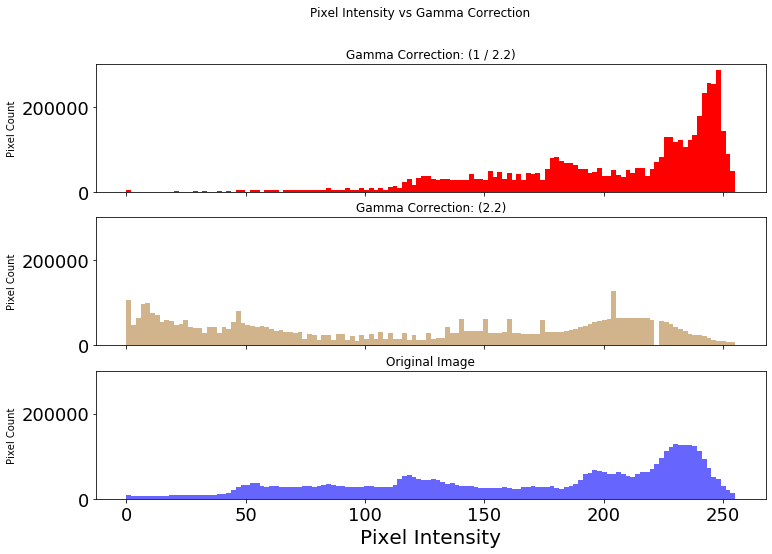

In [435]:

fig, axs = plt.subplots(3, sharex=True, sharey=True,figsize=(12,8))

fig.suptitle('Pixel Intensity vs Gamma Correction')
# plt.ylabel('Number of Pixels',size=20)
axs[0].hist(np.array(im_1_22).flatten(),128,color='red')
axs[0].set_title('Gamma Correction: (1 / 2.2)')
axs[1].hist(np.array(im_22).flatten(),128,color='tan')
axs[1].set_title('Gamma Correction: (2.2)')
axs[2].hist(np.array(bch).flatten(),128,color='blue',alpha=.6)
axs[2].set_title('Original Image')

plt.xlabel('Pixel Intensity',size=20)

for ax in axs.flat:
    ax.set( ylabel='Pixel Count')


plt.show()

In [439]:
import matplotlib.image as mpimg


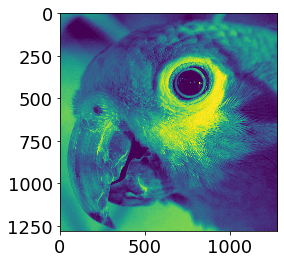

In [442]:
lum_img = np.array(parrot_)[:, :, 0]

plt.imshow(lum_img)

# https://matplotlib.org/3.3.3/tutorials/introductory/images.html

# `Array Interpolation:` 

+ trying to figure out what pixel color should be.
    + Common when we resize images
    + we are trying to preserve the colors/information even though the pixel around may change

+ Interpolation is trying to fix pixels that are missing by using surrounding pixels as a benchmark. This is why you can end up with distortion in images. Such as our witness protection parrot.


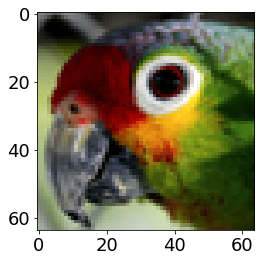

In [452]:
# Witness protection parrot :) hehe

img=parrot_.thumbnail((120, 120), Image.ANTIALIAS)  # resize img in-place
imgplot = plt.imshow(parrot_)


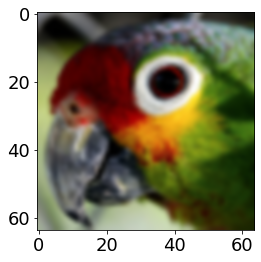

In [468]:
plt.imshow(parrot_, interpolation="bicubic")

# `Edge Detection:`

Valuable tool used in ML and Deep Learning, the concept is far reaching and very practical.

[basic types](https://www.geeksforgeeks.org/image-edge-detection-operators-in-digital-image-processing/)

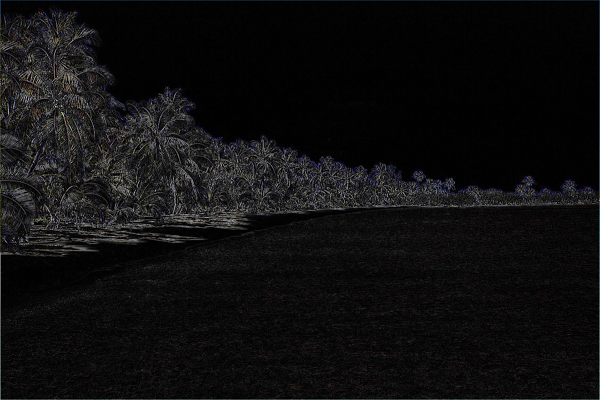

In [474]:
# Edge Detection:

bch.filter(ImageFilter.FIND_EDGES).resize((600,400))

# <font color=red>Like</font>,Share &

# <font color=red>SUB</font>scribe

**<font size=5>`Help Support the channel:Patreon @mrfugudatasci`</font>**

**<font size=4>`Or Buy Me A Coffee: @mrfugudatasci`</font>**

# `Citations & Help:`

# ◔̯◔

https://www.youtube.com/watch?v=CTOURPZftuU

https://scipy-lectures.org/advanced/image_processing/

https://neptune.ai/blog/image-processing-in-python-algorithms-tools-and-methods-you-should-know

https://www.toptal.com/opencv/python-image-processing-in-computational-photography

https://www.pythonforengineers.com/image-and-video-processing-in-python/

https://www.oreilly.com/library/view/programming-computer-vision/9781449341916/ch01.html

https://machinelearningmastery.com/computer-vision-books/

https://www.freecodecamp.org/news/how-to-create-generative-art-in-less-than-100-lines-of-code-d37f379859f/

https://aiartists.org/ai-generated-art-tools

https://www.analyticsvidhya.com/blog/2016/11/creating-an-artificial-artist-color-your-photos-using-neural-networks/

https://github.com/luanfujun

https://medium.com/mlreview/making-ai-art-with-style-transfer-using-keras-8bb5fa44b216

https://staff.fnwi.uva.nl/r.vandenboomgaard/IPCV20172018/20172018/LabExercises/introPython.html

https://www.kdnuggets.com/2018/09/image-data-analysis-python-p3.html

https://note.nkmk.me/en/python-numpy-image-processing/

https://note.nkmk.me/en/python-pillow-composite/

https://stackoverflow.com/questions/9211719/python-pil-image-error-after-image-load

https://www.geeksforgeeks.org/python-intensity-transformation-operations-on-images/

https://colab.research.google.com/github/xn2333/OpenCV/blob/master/Image_Processing_in_Python_Final.ipynb#scrollTo=6dy-iP-VTibt

https://matplotlib.org/3.1.1/gallery/statistics/histogram_multihist.html

https://www.dfstudios.co.uk/articles/programming/image-programming-algorithms/image-processing-algorithms-part-6-gamma-correction/

https://www.pyimagesearch.com/2015/10/05/opencv-gamma-correction/

**`FIGURES:`**

`Fig 01:` https://docs.opencv.org/3.4/d3/dc1/tutorial_basic_linear_transform.html

`Fig 02:` https://theailearner.com/2019/01/26/power-law-gamma-transformations/

`Fig 03:` https://note.nkmk.me/en/python-numpy-image-processing/